In [2]:
import numpy as np
import h5py
from PIL import Image
import os
import matplotlib.pyplot as plt

In [3]:
with h5py.File('train_catvnoncat.h5', "r") as train_dataset:
    train_set_x = np.array(train_dataset["train_set_x"][:])
    train_set_y = np.array(train_dataset["train_set_y"][:])

    print(f"Shape dữ liệu train - x: {train_set_x.shape}, y: {train_set_y.shape}")


with h5py.File('test_catvnoncat.h5', "r") as test_dataset:
    test_set_x = np.array(test_dataset["test_set_x"][:])
    test_set_y = np.array(test_dataset["test_set_y"][:])
    classes = np.array(test_dataset["list_classes"][:])

    print(f"Shape dữ liệu test - x: {test_set_x.shape}, y: {test_set_y.shape}")
    print(f"Classes: {[c.decode('utf-8') for c in classes]}")


Shape dữ liệu train - x: (209, 64, 64, 3), y: (209,)
Shape dữ liệu test - x: (50, 64, 64, 3), y: (50,)
Classes: ['non-cat', 'cat']


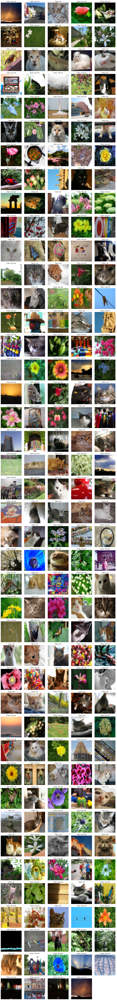

In [4]:
num_images = train_set_x.shape[0]

# Thiết lập lưới hiển thị: 5 cột, số hàng tính dựa trên tổng số hình ảnh
num_cols = 5
num_rows = int(np.ceil(num_images / num_cols))

# Tạo lưới subplot với kích thước phù hợp
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, num_rows * 3))

# Lặp qua tất cả các hình ảnh
for i in range(num_images):
    # Tính vị trí hàng và cột trong lưới
    row = i // num_cols
    col = i % num_cols
    
    # Lấy hình ảnh và nhãn tương ứng
    image = train_set_x[i]
    class_index = int(train_set_y[i])
    class_name = classes[class_index].decode('utf-8')
    
    # Hiển thị hình ảnh và đặt tiêu đề
    axes[row, col].imshow(image)
    axes[row, col].set_title(f'Class: {class_name}')
    axes[row, col].axis('off')  # Tắt trục tọa độ

# Ẩn các ô trống nếu số lượng hình ảnh không chia hết cho num_cols
for i in range(num_images, num_rows * num_cols):
    row = i // num_cols
    col = i % num_cols
    axes[row, col].axis('off')

# Điều chỉnh khoảng cách và hiển thị
plt.tight_layout()
plt.show()

In [5]:
train_set_y = train_set_y.reshape((1, train_set_y.shape[0]))
test_set_y = test_set_y.reshape((1, test_set_y.shape[0]))
train_set_x_flatten = train_set_x.reshape(train_set_x.shape[0], -1).T / 255.
test_set_x_flatten = test_set_x.reshape(test_set_x.shape[0], -1).T / 255.

print(f"Shape sau khi làm phẳng - Train: {train_set_x_flatten.shape}, Test: {test_set_x_flatten.shape}")

Shape sau khi làm phẳng - Train: (12288, 209), Test: (12288, 50)


In [6]:
def sigmoid(z):
    z = np.clip(z, -709, 709)
    return 1 / (1 + np.exp(-z))

def initialize_with_zeros(dim):
    w = np.zeros((dim, 1))
    b = 0.
    return w, b

def propagate(w, b, X, Y):
    m = X.shape[1]
    A = sigmoid(np.dot(w.T, X) + b)
    A = np.clip(A, 1e-14, 1 - 1e-14)
    cost = -1/m * (np.dot(Y, np.log(A).T) + np.dot(1 - Y, np.log(1 - A).T))[0, 0]
    dw = 1/m * np.dot(X, (A - Y).T)
    db = 1/m * np.sum(A - Y)
    return {"dw": dw, "db": db}, cost

def optimize(w, b, X, Y, num_iterations, learning_rate):
    print(f"Luyện tập với {num_iterations} lần lặp")
    costs = []
    for i in range(num_iterations):
        grads, cost = propagate(w, b, X, Y)
        w -= learning_rate * grads["dw"]
        b -= learning_rate * grads["db"]
        if i % 100 == 0:
            costs.append(cost)
            print(f"Giá trị cost tại iteration {i}: {cost:.7f}")
    return {"w": w, "b": b}, costs

def predict(w, b, X):
    A = sigmoid(np.dot(w.T, X) + b)
    return A

Luyện tập với 10000 lần lặp
Giá trị cost tại iteration 0: 0.6931472
Giá trị cost tại iteration 100: 0.8239209
Giá trị cost tại iteration 200: 0.4189444
Giá trị cost tại iteration 300: 0.6173497
Giá trị cost tại iteration 400: 0.5221158
Giá trị cost tại iteration 500: 0.3877087
Giá trị cost tại iteration 600: 0.2362545
Giá trị cost tại iteration 700: 0.1542221
Giá trị cost tại iteration 800: 0.1353278
Giá trị cost tại iteration 900: 0.1249715
Giá trị cost tại iteration 1000: 0.1164783
Giá trị cost tại iteration 1100: 0.1091925
Giá trị cost tại iteration 1200: 0.1028045
Giá trị cost tại iteration 1300: 0.0971298
Giá trị cost tại iteration 1400: 0.0920433
Giá trị cost tại iteration 1500: 0.0874525
Giá trị cost tại iteration 1600: 0.0832860
Giá trị cost tại iteration 1700: 0.0794866
Giá trị cost tại iteration 1800: 0.0760073
Giá trị cost tại iteration 1900: 0.0728095
Giá trị cost tại iteration 2000: 0.0698604
Giá trị cost tại iteration 2100: 0.0671322
Giá trị cost tại iteration 2200: 0.064

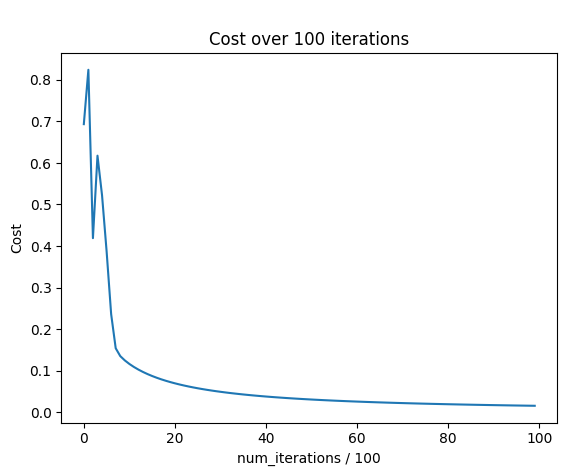

In [7]:
def model(X_train, Y_train, X_test, Y_test, num_iterations=10000, learning_rate=0.01):
    dim = X_train.shape[0]
    w, b = initialize_with_zeros(dim)
    parameters, costs = optimize(w, b, X_train, Y_train, num_iterations, learning_rate)
    w = parameters["w"]
    b = parameters["b"]
    Y_prediction_test = predict(w, b, X_test)
    Y_prediction_train = predict(w, b, X_train)
    
    # Tính độ chính xác
    train_accuracy = 100 - np.mean(np.abs(Y_prediction_train - Y_train)) * 100
    test_accuracy = 100 - np.mean(np.abs(Y_prediction_test - Y_test)) * 100
    
    print(f"\nĐộ chính xác trên tập train: {train_accuracy:.5f}%")
    print(f"Độ chính xác trên tập test: {test_accuracy:.5f}%")

    plt.plot(costs)
    plt.xlabel("num_iterations / 100")
    plt.ylabel("Cost")
    plt.title(f"\nCost over 100 iterations")
    plt.show()

    train_predictions = (Y_prediction_train > 0.5).astype(int)
    test_predictions = (Y_prediction_test > 0.5).astype(int)
    
    return Y_prediction_train, Y_prediction_test, {"w": w, "b": b}

Y_prediction_train, Y_prediction_test, d = model(train_set_x_flatten, train_set_y, test_set_x_flatten, test_set_y)

In [8]:
def predict_images_from_folder(folder_path, d, classes):

    print(f"Dự đoán ảnh từ thư mục: {folder_path}")
    print(f"Kích thước ảnh yêu cầu: {train_set_x.shape[1]}x{train_set_x.shape[2]}")
    print("-" * 30)

    for file_name in os.listdir(folder_path):
        file_path = os.path.join(folder_path, file_name)

        if file_name.lower().endswith(('.png', '.jpg', '.jpeg')):
            try:
                image = Image.open(file_path)
                height, width = train_set_x.shape[1:3]
                resized_image = image.resize((width, height))
                my_image = np.array(resized_image).reshape((1, -1)).T / 255.
                my_predicted_prob = predict(d["w"], d["b"], my_image)
                my_predicted_image = (my_predicted_prob > 0.5).astype(int)

                plt.imshow(image)
                plt.axis('off')
                plt.show()

                print(f"File: {file_name}")
                print("Tỷ lệ cat: {:.2f}%".format(np.squeeze(my_predicted_prob) * 100))
                print(f"Kết quả dự đoán là: \"{classes[int(np.squeeze(my_predicted_image))].decode('utf-8')}\".")
                print("-" * 30)

            except Exception as e:
                print(f"Không thể xử lý file {file_name}: {e}")

Dự đoán ảnh từ thư mục: ./test_images/versions/11
Kích thước ảnh yêu cầu: 64x64
------------------------------


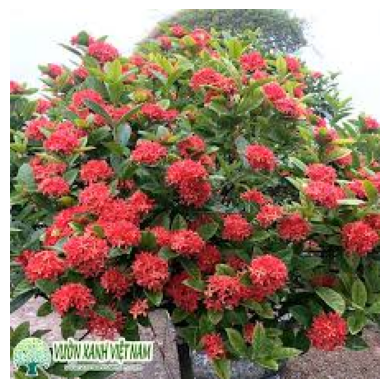

File: caay 5.jpg
Tỷ lệ cat: 6.07%
Kết quả dự đoán là: "non-cat".
------------------------------


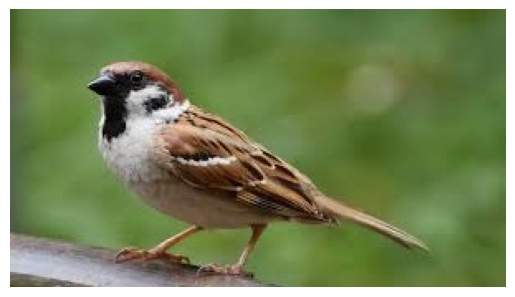

File: chim 2.jpg
Tỷ lệ cat: 0.07%
Kết quả dự đoán là: "non-cat".
------------------------------


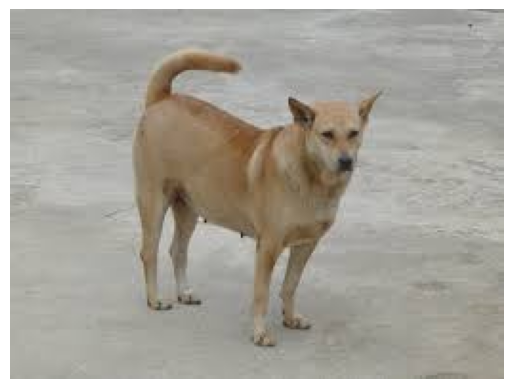

File: chó 1.jpg
Tỷ lệ cat: 24.89%
Kết quả dự đoán là: "non-cat".
------------------------------


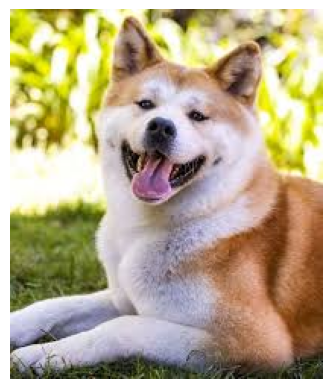

File: chó 2.jpg
Tỷ lệ cat: 93.78%
Kết quả dự đoán là: "cat".
------------------------------


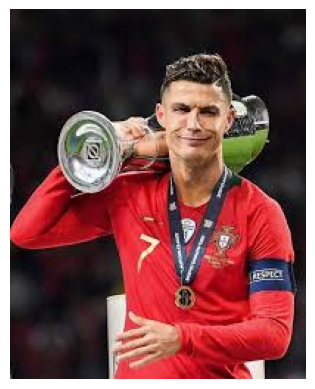

File: con người 1.jpg
Tỷ lệ cat: 14.58%
Kết quả dự đoán là: "non-cat".
------------------------------


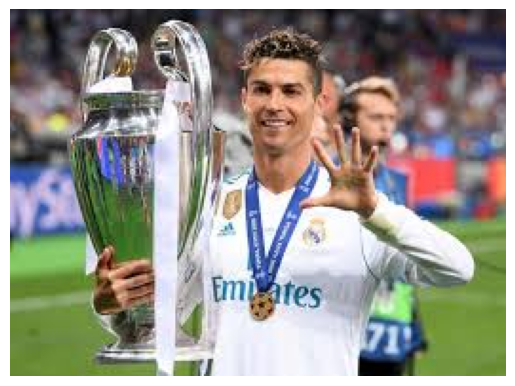

File: con người 2.jpg
Tỷ lệ cat: 0.96%
Kết quả dự đoán là: "non-cat".
------------------------------


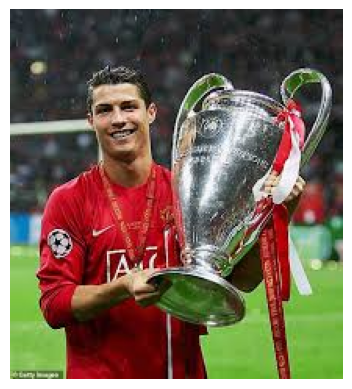

File: con người 3.jpg
Tỷ lệ cat: 17.69%
Kết quả dự đoán là: "non-cat".
------------------------------


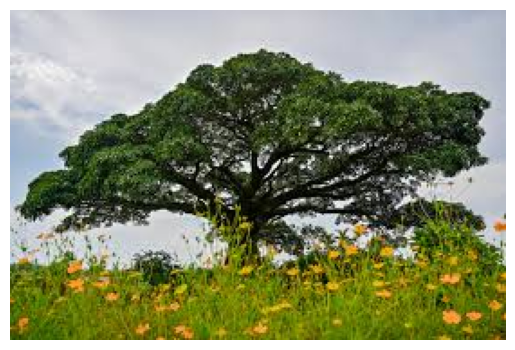

File: cây 1.jpg
Tỷ lệ cat: 1.08%
Kết quả dự đoán là: "non-cat".
------------------------------


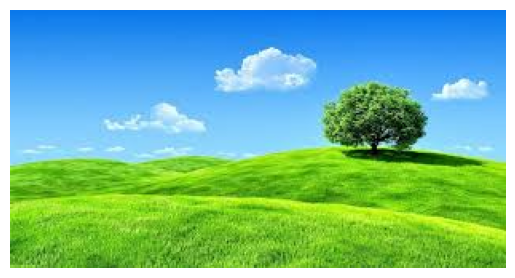

File: cây 4.jpg
Tỷ lệ cat: 0.00%
Kết quả dự đoán là: "non-cat".
------------------------------


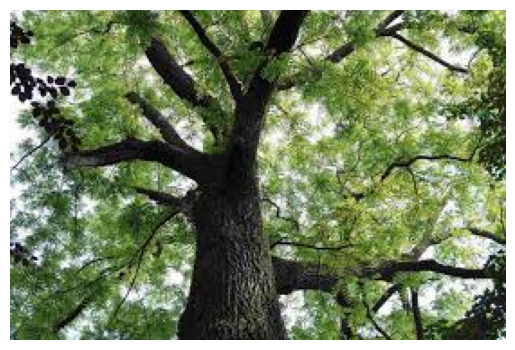

File: cây 6.jpg
Tỷ lệ cat: 0.03%
Kết quả dự đoán là: "non-cat".
------------------------------


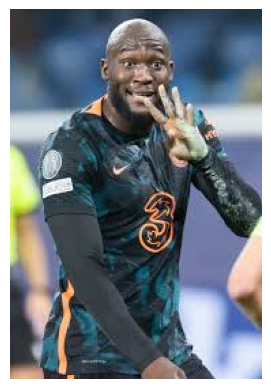

File: da den 1.jpg
Tỷ lệ cat: 99.06%
Kết quả dự đoán là: "cat".
------------------------------


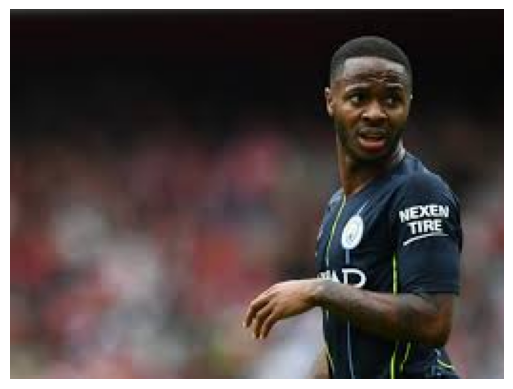

File: da den 2.jpg
Tỷ lệ cat: 30.86%
Kết quả dự đoán là: "non-cat".
------------------------------


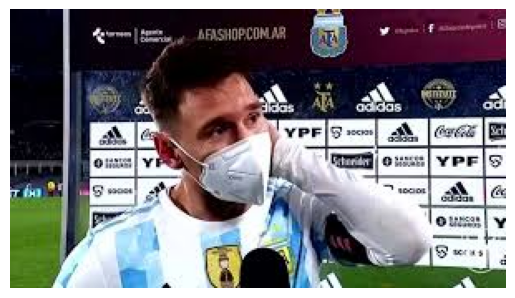

File: da trang 2.jpg
Tỷ lệ cat: 99.92%
Kết quả dự đoán là: "cat".
------------------------------


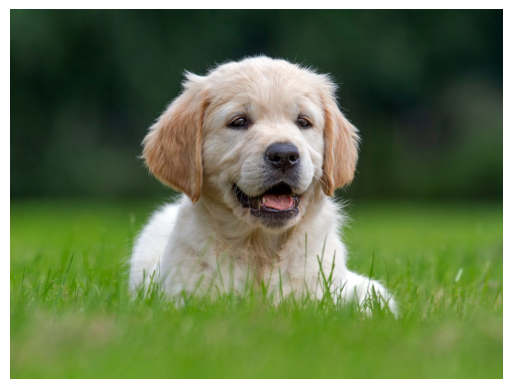

File: dog.jpg
Tỷ lệ cat: 16.79%
Kết quả dự đoán là: "non-cat".
------------------------------


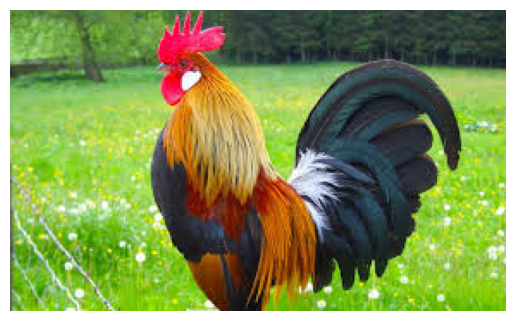

File: gà 1.jpg
Tỷ lệ cat: 0.00%
Kết quả dự đoán là: "non-cat".
------------------------------


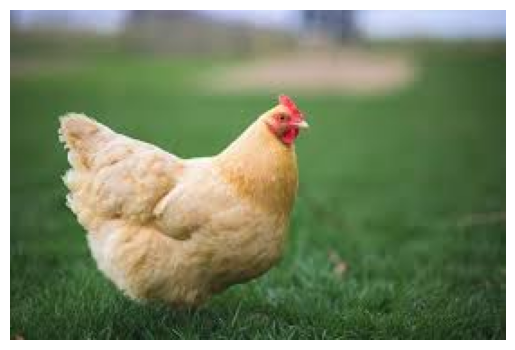

File: gà 3.jpg
Tỷ lệ cat: 1.49%
Kết quả dự đoán là: "non-cat".
------------------------------


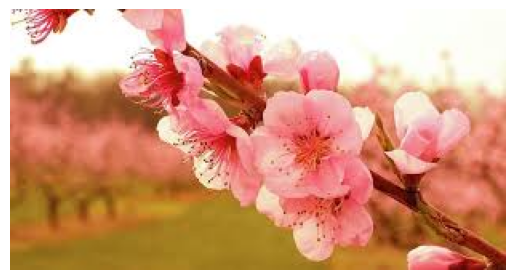

File: hoa 2.jpg
Tỷ lệ cat: 1.90%
Kết quả dự đoán là: "non-cat".
------------------------------


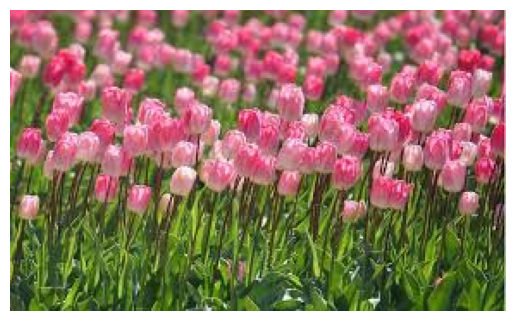

File: hoa 4.jpg
Tỷ lệ cat: 17.54%
Kết quả dự đoán là: "non-cat".
------------------------------


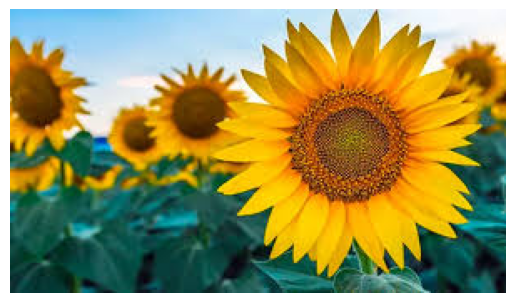

File: hoa 6.jpg
Tỷ lệ cat: 0.15%
Kết quả dự đoán là: "non-cat".
------------------------------


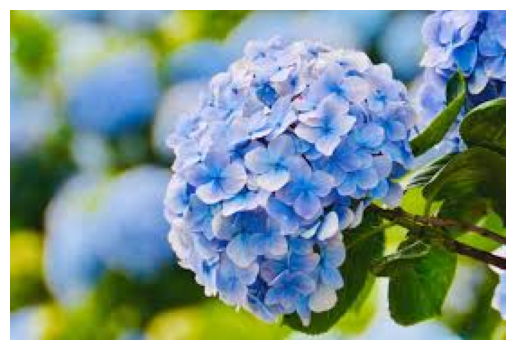

File: hoa 7.jpg
Tỷ lệ cat: 14.40%
Kết quả dự đoán là: "non-cat".
------------------------------


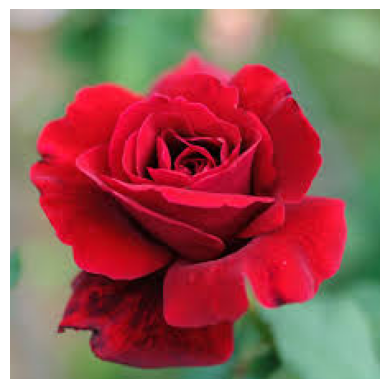

File: hoa 8.jpg
Tỷ lệ cat: 0.82%
Kết quả dự đoán là: "non-cat".
------------------------------


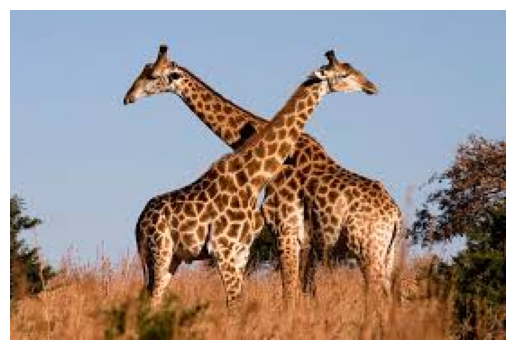

File: hươu cao cổ.jpg
Tỷ lệ cat: 0.04%
Kết quả dự đoán là: "non-cat".
------------------------------


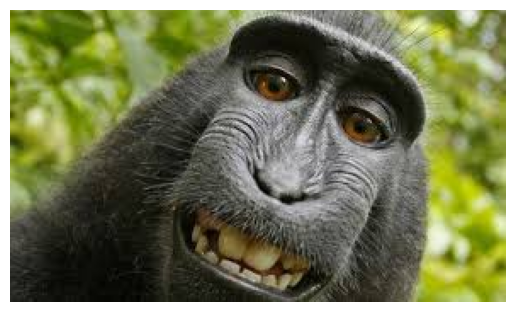

File: khỉ 1.jpg
Tỷ lệ cat: 0.01%
Kết quả dự đoán là: "non-cat".
------------------------------


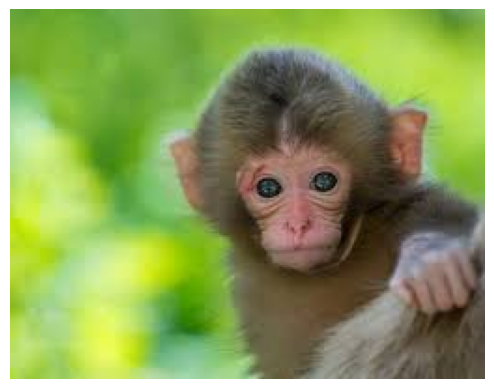

File: khỉ 2.jpg
Tỷ lệ cat: 3.70%
Kết quả dự đoán là: "non-cat".
------------------------------


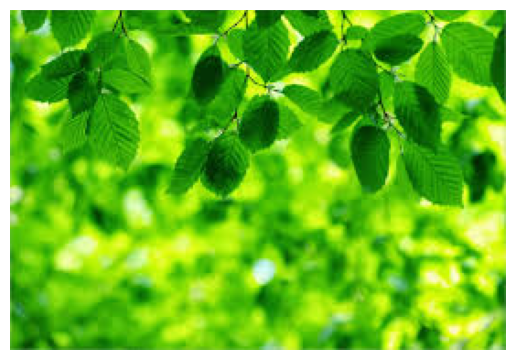

File: lá 2.jpg
Tỷ lệ cat: 0.00%
Kết quả dự đoán là: "non-cat".
------------------------------


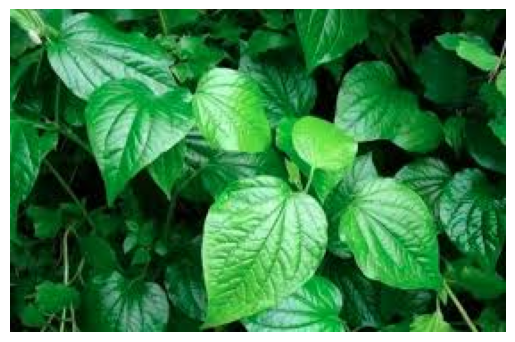

File: lá 4.jpg
Tỷ lệ cat: 0.32%
Kết quả dự đoán là: "non-cat".
------------------------------


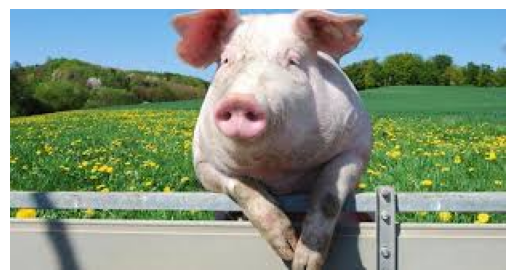

File: lợn 2.jpg
Tỷ lệ cat: 1.19%
Kết quả dự đoán là: "non-cat".
------------------------------


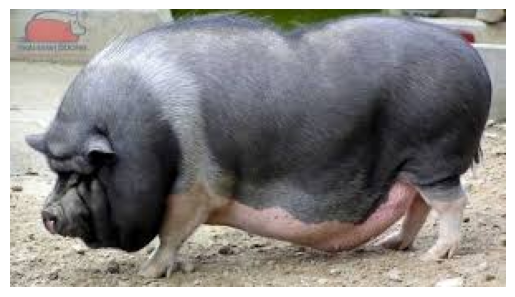

File: Lợn.jpg
Tỷ lệ cat: 97.09%
Kết quả dự đoán là: "cat".
------------------------------


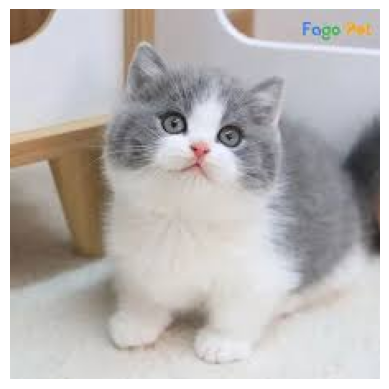

File: Mèo 1.jpg
Tỷ lệ cat: 69.27%
Kết quả dự đoán là: "cat".
------------------------------


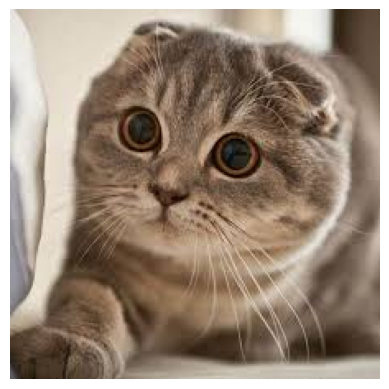

File: Mèo 2.jpg
Tỷ lệ cat: 2.13%
Kết quả dự đoán là: "non-cat".
------------------------------


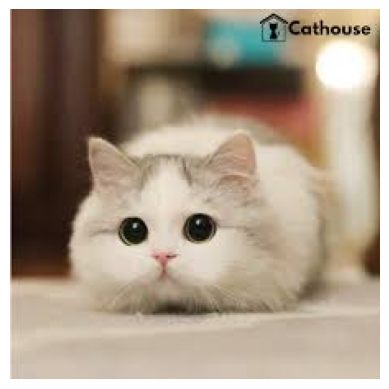

File: Mèo 3.jpg
Tỷ lệ cat: 71.12%
Kết quả dự đoán là: "cat".
------------------------------


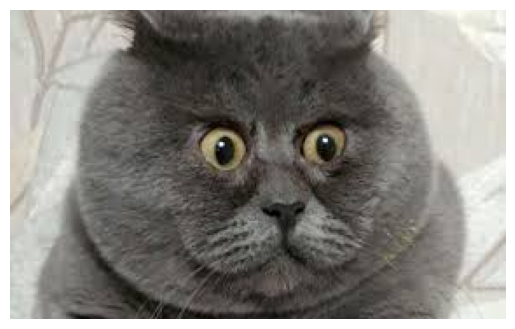

File: Mèo 4.jpg
Tỷ lệ cat: 0.01%
Kết quả dự đoán là: "non-cat".
------------------------------


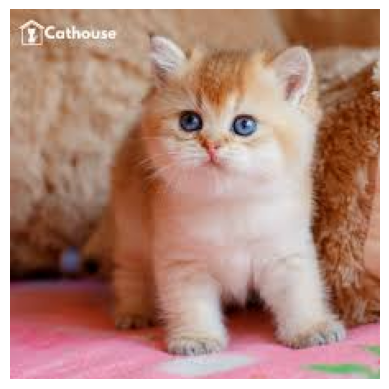

File: Mèo 5.jpg
Tỷ lệ cat: 99.94%
Kết quả dự đoán là: "cat".
------------------------------


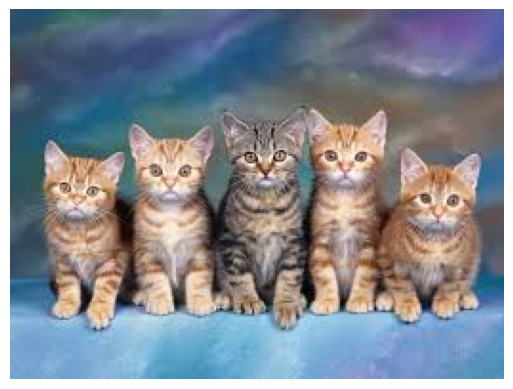

File: Mèo 8.jpg
Tỷ lệ cat: 74.34%
Kết quả dự đoán là: "cat".
------------------------------


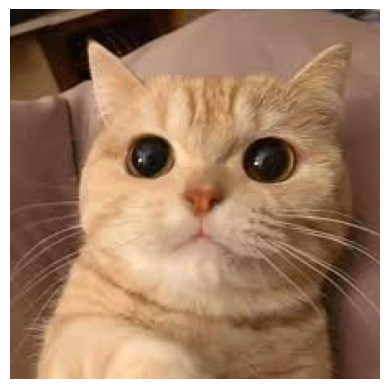

File: Mèo 9.jpg
Tỷ lệ cat: 99.82%
Kết quả dự đoán là: "cat".
------------------------------


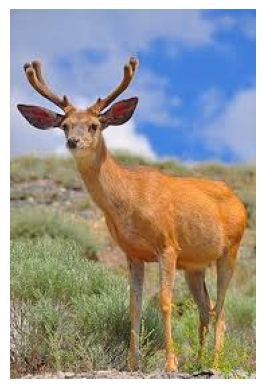

File: nai.jpg
Tỷ lệ cat: 2.78%
Kết quả dự đoán là: "non-cat".
------------------------------


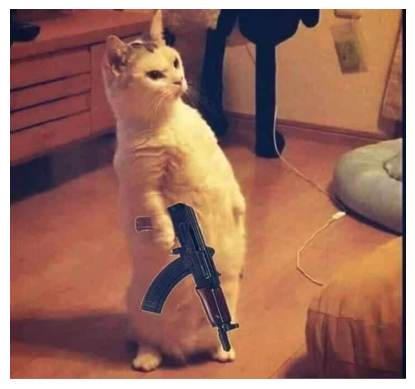

File: photo_10_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 98.34%
Kết quả dự đoán là: "cat".
------------------------------


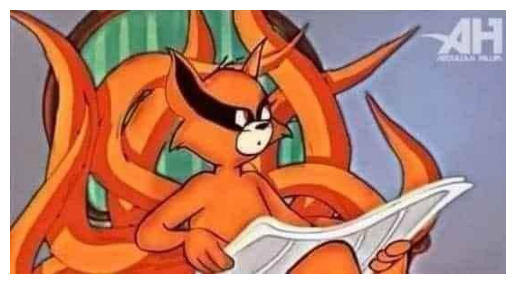

File: photo_10_2025-03-16_14-59-42.jpg
Tỷ lệ cat: 12.83%
Kết quả dự đoán là: "non-cat".
------------------------------


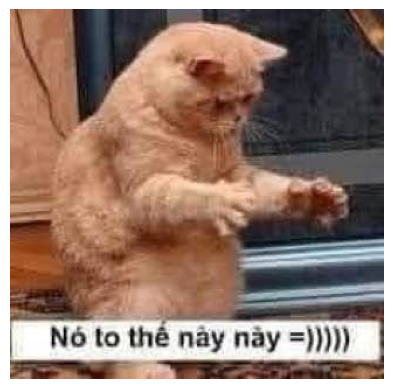

File: photo_11_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 20.23%
Kết quả dự đoán là: "non-cat".
------------------------------


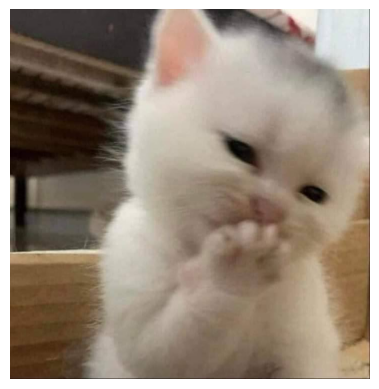

File: photo_12_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 98.58%
Kết quả dự đoán là: "cat".
------------------------------


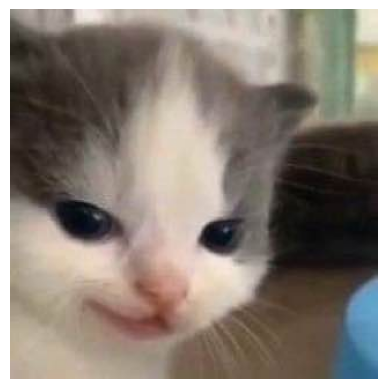

File: photo_13_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 93.57%
Kết quả dự đoán là: "cat".
------------------------------


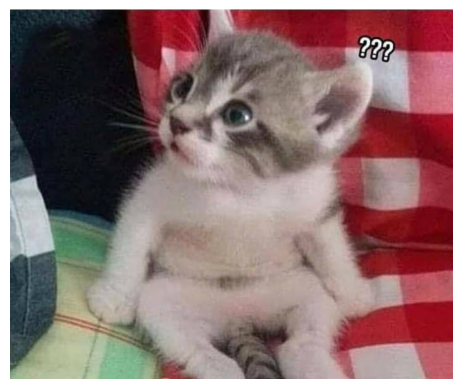

File: photo_14_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 99.98%
Kết quả dự đoán là: "cat".
------------------------------


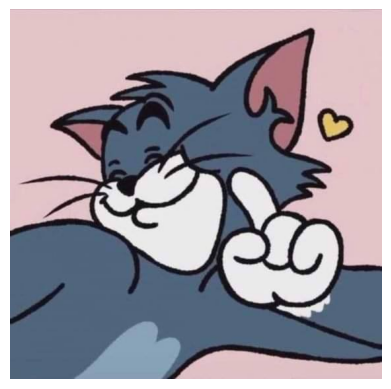

File: photo_15_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 99.89%
Kết quả dự đoán là: "cat".
------------------------------


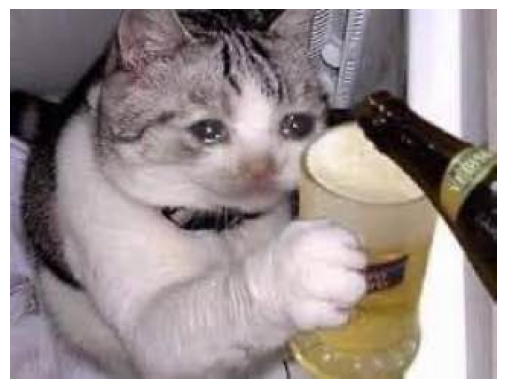

File: photo_16_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 73.41%
Kết quả dự đoán là: "cat".
------------------------------


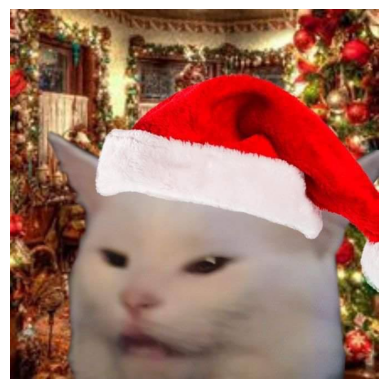

File: photo_17_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 58.98%
Kết quả dự đoán là: "cat".
------------------------------


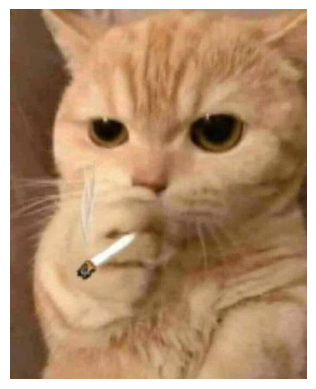

File: photo_18_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 94.97%
Kết quả dự đoán là: "cat".
------------------------------


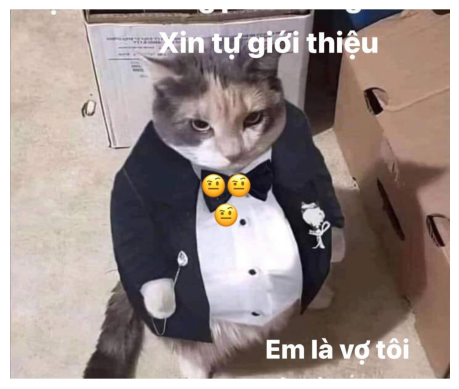

File: photo_19_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 3.36%
Kết quả dự đoán là: "non-cat".
------------------------------


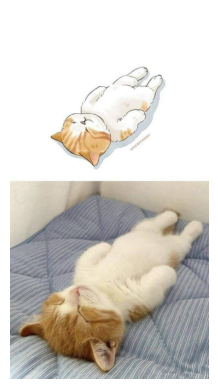

File: photo_1_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 0.46%
Kết quả dự đoán là: "non-cat".
------------------------------


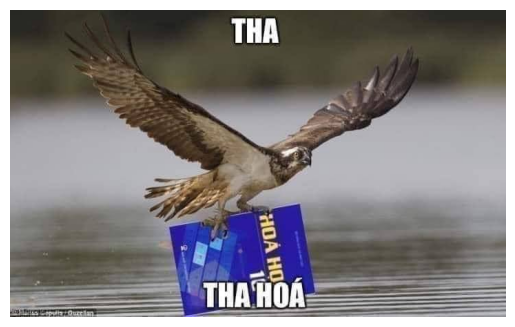

File: photo_1_2025-03-16_14-59-42.jpg
Tỷ lệ cat: 18.94%
Kết quả dự đoán là: "non-cat".
------------------------------


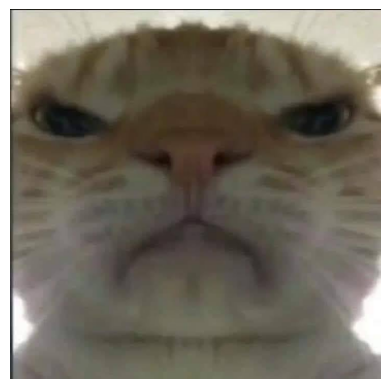

File: photo_20_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 30.23%
Kết quả dự đoán là: "non-cat".
------------------------------


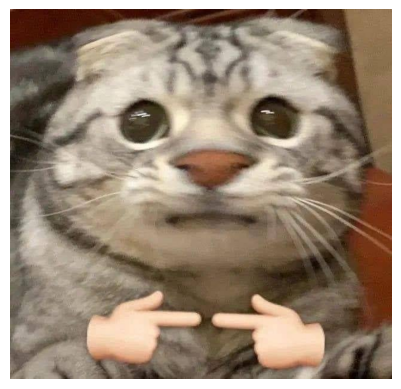

File: photo_21_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 28.35%
Kết quả dự đoán là: "non-cat".
------------------------------


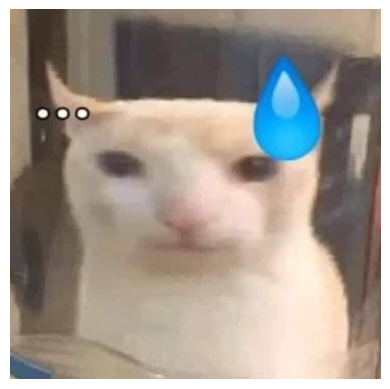

File: photo_23_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 98.94%
Kết quả dự đoán là: "cat".
------------------------------


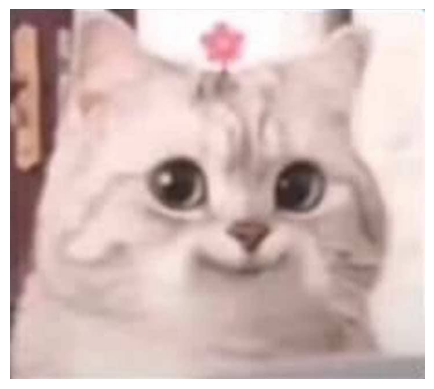

File: photo_24_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 91.89%
Kết quả dự đoán là: "cat".
------------------------------


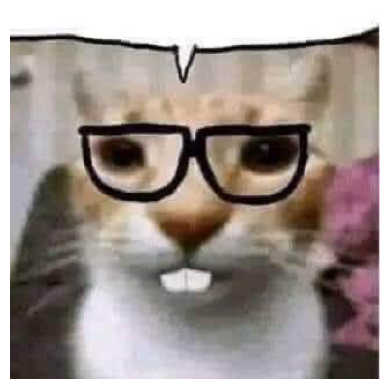

File: photo_25_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 99.93%
Kết quả dự đoán là: "cat".
------------------------------


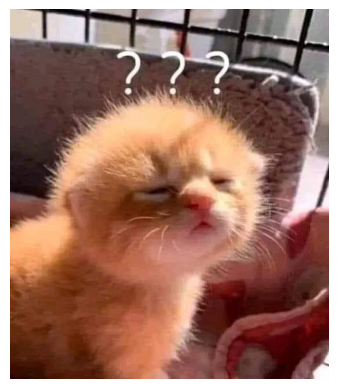

File: photo_26_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 0.24%
Kết quả dự đoán là: "non-cat".
------------------------------


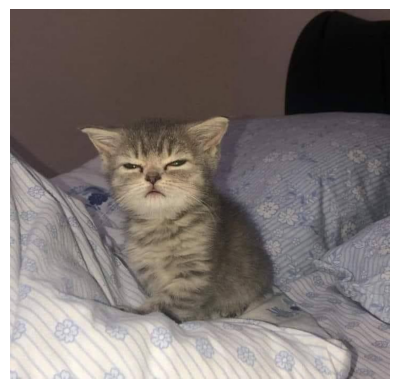

File: photo_2_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 96.80%
Kết quả dự đoán là: "cat".
------------------------------


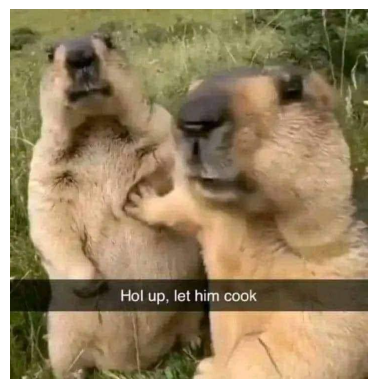

File: photo_2_2025-03-16_14-59-42.jpg
Tỷ lệ cat: 0.51%
Kết quả dự đoán là: "non-cat".
------------------------------


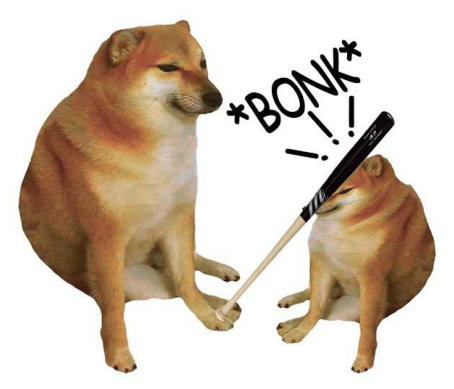

File: photo_3_2025-03-16_14-59-42.jpg
Tỷ lệ cat: 4.53%
Kết quả dự đoán là: "non-cat".
------------------------------


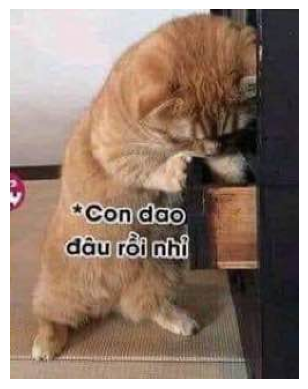

File: photo_4_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 2.59%
Kết quả dự đoán là: "non-cat".
------------------------------


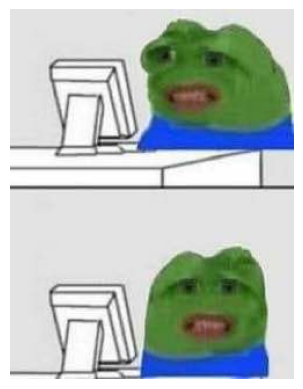

File: photo_4_2025-03-16_14-59-42.jpg
Tỷ lệ cat: 4.28%
Kết quả dự đoán là: "non-cat".
------------------------------


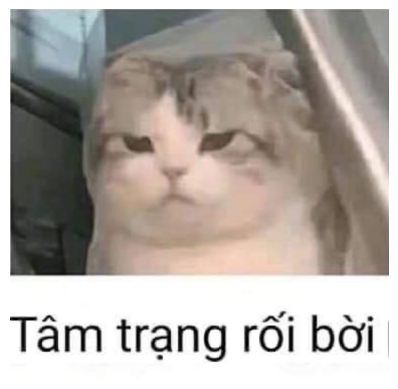

File: photo_5_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 93.33%
Kết quả dự đoán là: "cat".
------------------------------


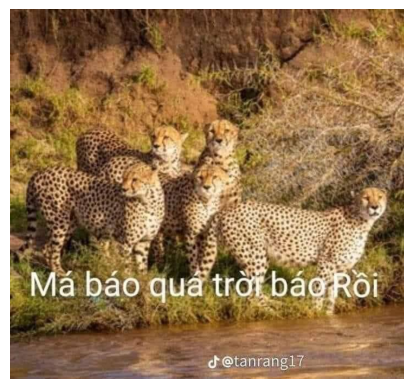

File: photo_5_2025-03-16_14-59-42.jpg
Tỷ lệ cat: 95.33%
Kết quả dự đoán là: "cat".
------------------------------


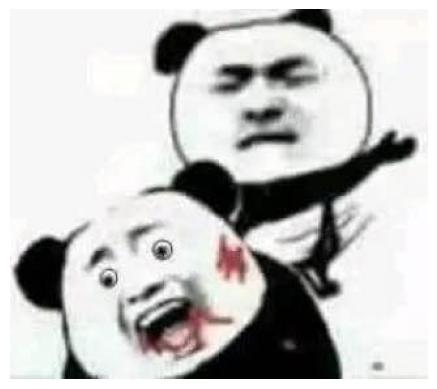

File: photo_6_2025-03-16_14-59-42.jpg
Tỷ lệ cat: 47.60%
Kết quả dự đoán là: "non-cat".
------------------------------


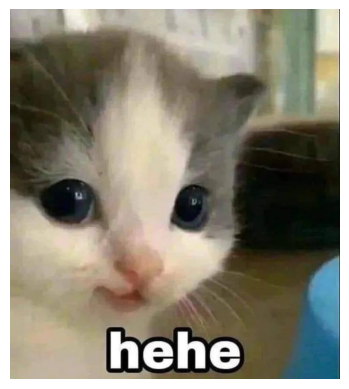

File: photo_7_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 88.05%
Kết quả dự đoán là: "cat".
------------------------------


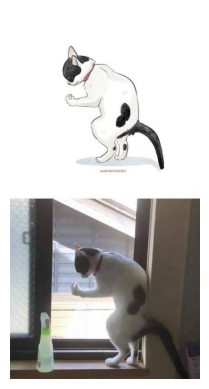

File: photo_8_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 0.03%
Kết quả dự đoán là: "non-cat".
------------------------------


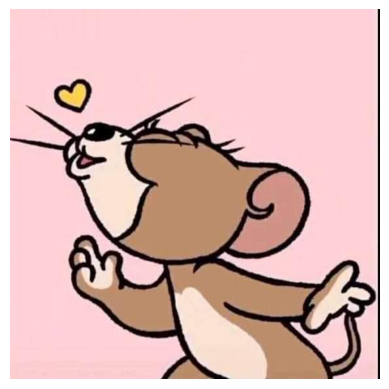

File: photo_8_2025-03-16_14-59-42.jpg
Tỷ lệ cat: 25.69%
Kết quả dự đoán là: "non-cat".
------------------------------


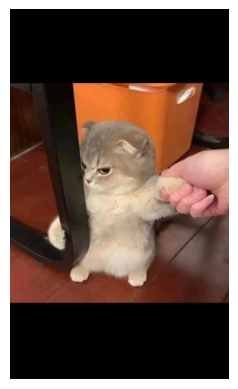

File: photo_9_2025-03-16_14-52-45.jpg
Tỷ lệ cat: 0.65%
Kết quả dự đoán là: "non-cat".
------------------------------


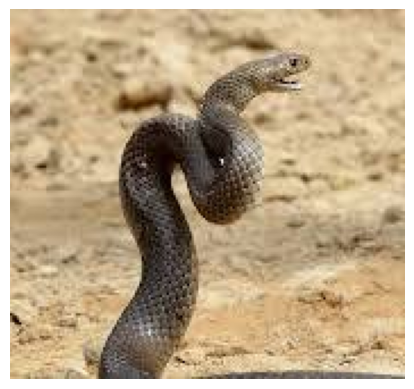

File: rắn 1.jpg
Tỷ lệ cat: 89.63%
Kết quả dự đoán là: "cat".
------------------------------


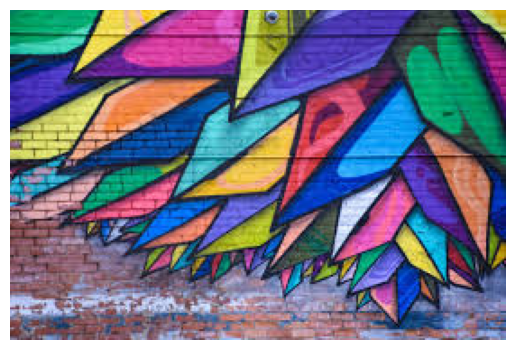

File: tường 2.jpg
Tỷ lệ cat: 33.85%
Kết quả dự đoán là: "non-cat".
------------------------------


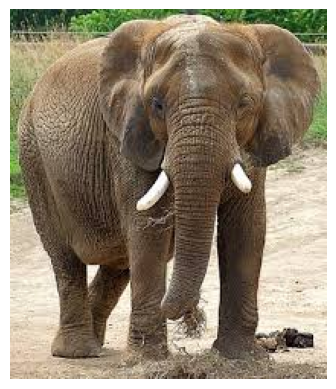

File: voi 1.jpg
Tỷ lệ cat: 0.05%
Kết quả dự đoán là: "non-cat".
------------------------------


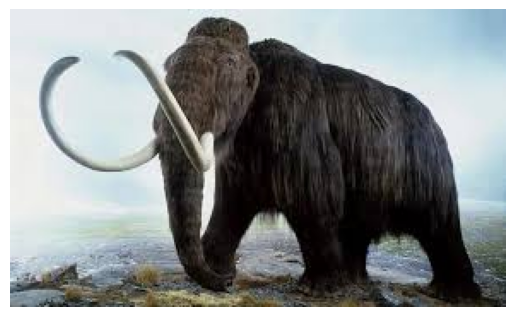

File: voi 2.jpg
Tỷ lệ cat: 0.54%
Kết quả dự đoán là: "non-cat".
------------------------------


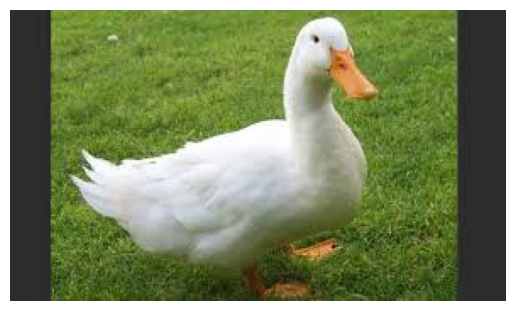

File: vịt.jpg
Tỷ lệ cat: 4.89%
Kết quả dự đoán là: "non-cat".
------------------------------


In [9]:
image_test_folder = './test_images/versions/11'
predict_images_from_folder(image_test_folder, d, classes)